In [441]:
import warnings
warnings.filterwarnings('ignore')

import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
import seaborn as sns
import plotly.express as px

import pandas_profiling as pp

# Preprocessing
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler

# Fetures selection
from sklearn.feature_selection import SelectKBest, f_classif, chi2
from sklearn.decomposition import PCA

# Models
from sklearn.cluster import KMeans, AgglomerativeClustering, DBSCAN, SpectralClustering, AffinityPropagation, Birch, MeanShift, OPTICS

# Model selection
from sklearn.model_selection import train_test_split, GridSearchCV, RepeatedKFold, StratifiedKFold, cross_val_score

# Neural network
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Dense, Conv2D, MaxPooling2D, Flatten
from keras.optimizers import Adam
from kerastuner.tuners import RandomSearch

# Resampling
from imblearn.over_sampling import SMOTE, ADASYN, RandomOverSampler
from imblearn.under_sampling import InstanceHardnessThreshold, RandomUnderSampler, NearMiss

# Classification metrics
from sklearn.metrics import classification_report, confusion_matrix , silhouette_score , rand_score , adjusted_mutual_info_score, mutual_info_score

# Pipeline
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.compose import ColumnTransformer
from sklearn.base import BaseEstimator, TransformerMixin

# Make image directory (img)
import os
currDir = os.getcwd()
if not os.path.exists('img'):
    os.mkdir('img')

In [442]:
df = pd.read_csv('dfKmeans.csv')
dfCate = df.select_dtypes(include=['object'])

<hr>

## **Model 1 : K-Means clustering**

Since k-means clustering is a clustering algorithm, we will be using the unsupervised learning method to predict the output. and k-means prefers numerical data, we will be using numerical features only. The k-Means algorithm is not applicable to categorical data, as categorical variables are discrete and do not have any natural origin. So computing euclidean distance for such as space is not meaningful.

In [443]:
dfKmeans = df.copy()
# dfKmeans = dfKmeans.drop(dfCate.columns, axis = 1)
dfKmeans.head()

,age,balance,day,campaign,pdays,previous,y
0,58,2143,5,1,-1,0,0
1,44,29,5,1,-1,0,0
2,33,2,5,1,-1,0,0
3,47,1506,5,1,-1,0,0
4,33,1,5,1,-1,0,0


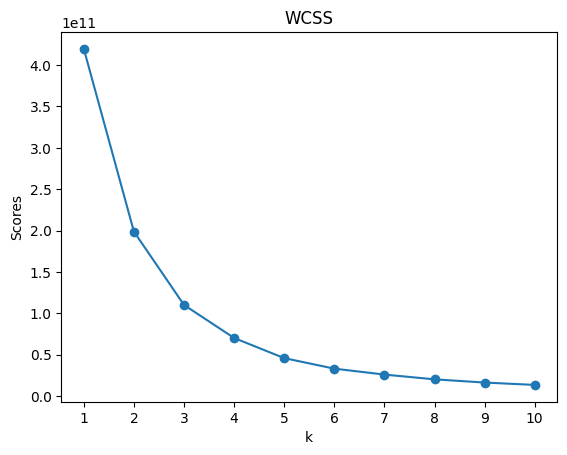

In [444]:
Num_K = [i+1 for i in range(10)]
WCSS = []

for k in Num_K:
  kmeans_clf_Ex1 = KMeans(n_clusters=k,
                          random_state=1,
                          )
  model = kmeans_clf_Ex1.fit(dfKmeans.drop('y', axis=1))
  WCSS.append(model.inertia_)
  
plt.scatter(Num_K,WCSS )
plt.plot(Num_K,WCSS )
plt.title('WCSS')
plt.xticks(Num_K)
plt.ylabel('Scores'),plt.xlabel('k')
plt.show()

In [445]:
# Num_K = [i+2 for i in range(9)]
# silhouette_coef = []

# for k in Num_K:
#   kmeans_clf_Ex1 = KMeans(n_clusters=k, random_state=1,)
#   model = kmeans_clf_Ex1.fit(dfKmeans.drop('y', axis=1))
#   labels = model.labels_
#   silhouette_coef.append(silhouette_score(dfKmeans.drop('y', axis=1), labels, metric='euclidean'))

# plt.scatter(Num_K,silhouette_coef )
# plt.plot(Num_K,silhouette_coef )
# plt.title('silhouette')
# plt.xticks(Num_K)
# plt.ylabel('Scores'),plt.xlabel('k')
# plt.show()

In [446]:
kmeans_clf_Ex1_Base = KMeans(n_clusters=2, random_state=1)
kmeans_clf_Ex1_Base = kmeans_clf_Ex1_Base.fit(dfKmeans.drop(['y'], axis=1))

Pridict_base = kmeans_clf_Ex1_Base.predict(dfKmeans.drop(['y'], axis=1))
score_base = rand_score(dfKmeans['y'], Pridict_base)
# rc = silhouette_score(dfKmeans.drop(['y'], axis=1), Pridict_base, metric='euclidean', random_state=1)
# print('Silhouette score: ', rc)
print('Rand score: ', score_base)
print('Model Centroids: \n', kmeans_clf_Ex1_Base.cluster_centers_)
print(kmeans_clf_Ex1_Base.labels_.shape)

Rand score:  0.7500149497477122
Model Centroids: 
 [[4.08155663e+01 8.96882074e+02 1.57919719e+01 2.76798466e+00
  4.02478682e+01 5.76479560e-01]
 [4.36852237e+01 1.18516670e+04 1.60941727e+01 2.67377732e+00
  3.94141519e+01 6.71696150e-01]]
(45195,)


In [447]:
def KMeansModelGenerator(df, target ,k):
  kmeans_clf = KMeans(n_clusters=k, random_state=1,)
  kmeans_clf = kmeans_clf.fit(df.drop(target, axis=1))
  labels = model.labels_
  df['cluster'] = labels
  randScore = rand_score(df[target], labels)
  print('Rand score: ', randScore)
  print('WCSS: ', kmeans_clf.inertia_)
  print('Model Centroids: \n', kmeans_clf.cluster_centers_)
  return kmeans_clf , df

### **Data Preprocessing**

#### **Experiment 1 : Remove Outliers**

##### **Hypothesis**
    
Outliers in features affects model's performance.

From the figure,

<img src='img/BoxStrip.png'/>

we will be removing outliers from the following features:
- balance
- campaign
- previous

In [448]:
dfkmOri = dfKmeans.copy()

##### **Check Point**

In [449]:
dfKmeans = dfkmOri.copy()
dfKmeans_Ex1 = dfKmeans.copy()

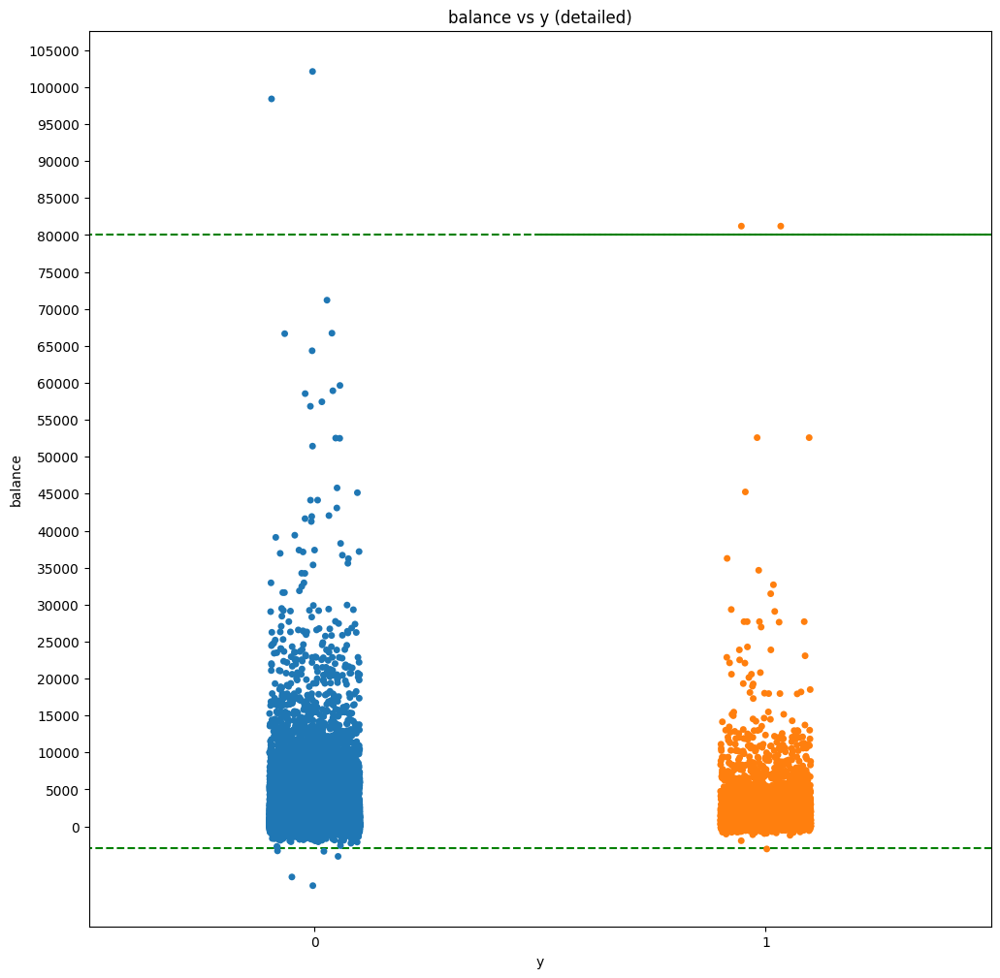

In [450]:
# balance0_threshold = 50000
# balance1_threshold = 45000
balance0_threshold = 80000
balance1_threshold = 80000
balanceMinus_threshold = -3000

plt.figure(figsize=(12, 12))
plt.title('balance vs y (detailed)')
plt.yticks(np.arange(0, 120000, 5000))
plt.plot(np.arange(-1, 3, 1), np.full(4, balance0_threshold), 'g--')
plt.plot(np.arange(-1, 3, 1), np.full(4, balanceMinus_threshold), 'g--')
plt.plot(np.arange(0.5, 3, 1), np.full(3, balance1_threshold), 'g--')
sns.stripplot(x="y", y="balance", data=dfKmeans_Ex1)
# plt.savefig('img/balance-y-detailed.png', bbox_inches='tight')
plt.show()

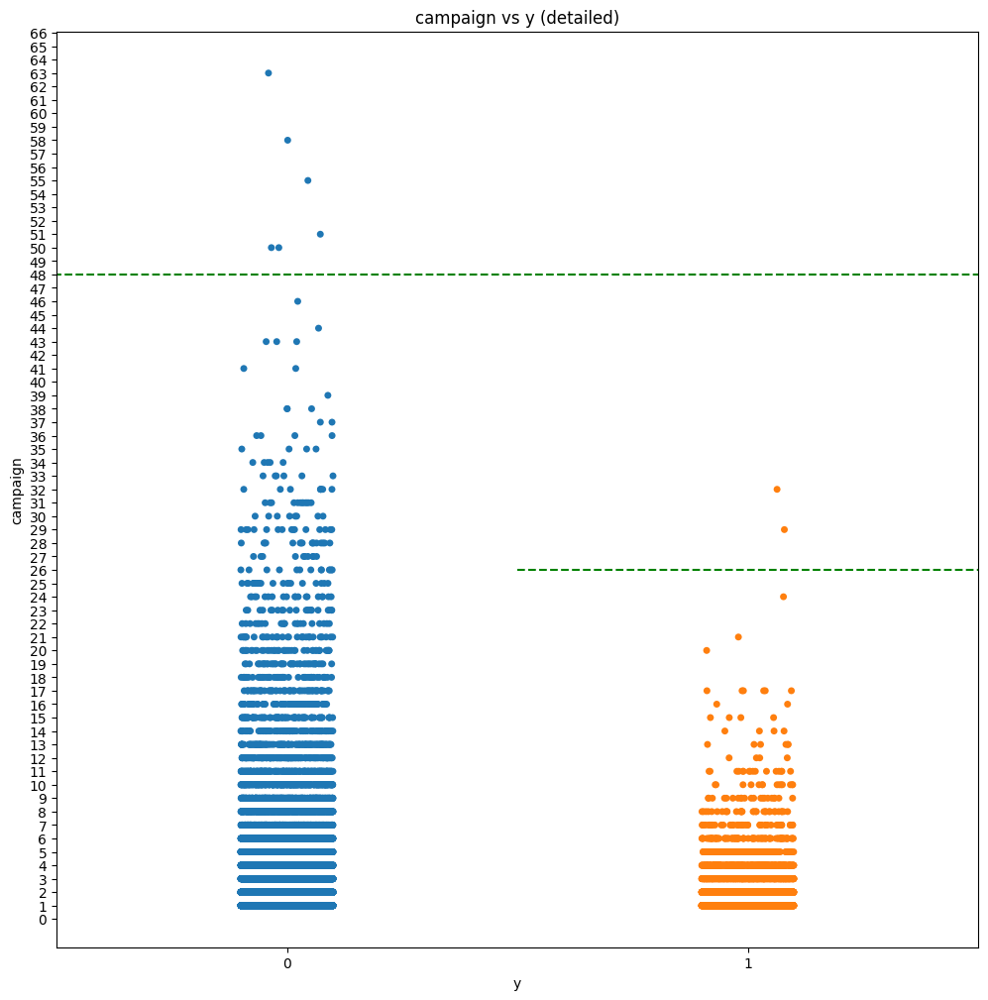

In [451]:
# campaign0_threshold = 40
# campaign1_threshold = 18
campaign0_threshold = 48
campaign1_threshold = 26

plt.figure(figsize=(12, 12))
plt.title('campaign vs y (detailed)')
plt.yticks(np.arange(0, 70, 1))
plt.plot(np.arange(-1, 3, 1), np.full(4, campaign0_threshold), 'g--')
plt.plot(np.arange(0.5, 3, 1), np.full(3, campaign1_threshold), 'g--')
sns.stripplot(x="y", y="campaign", data=dfKmeans_Ex1)
# plt.savefig('img/campaign-y-detailed.png', bbox_inches='tight')
plt.show()

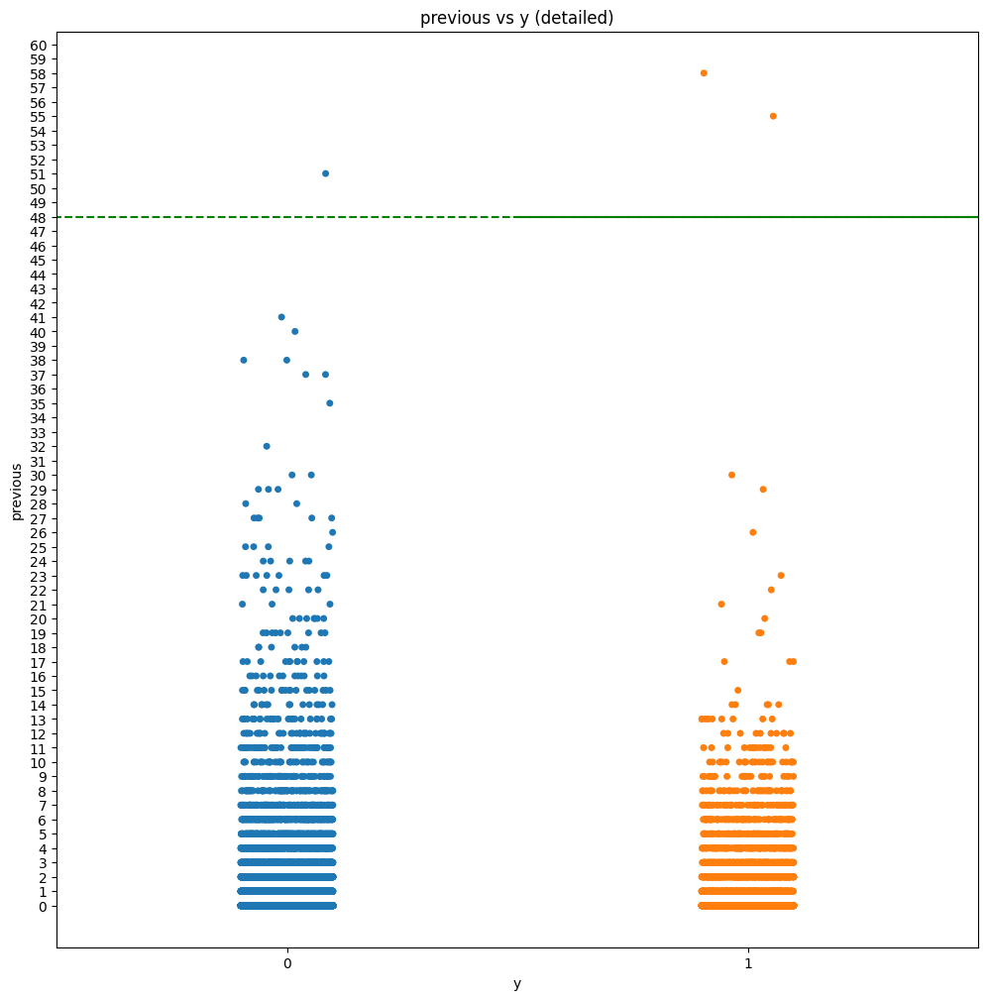

In [452]:
dfKmeans_Ex1 = dfKmeans_Ex1.drop(dfKmeans_Ex1[dfKmeans_Ex1['previous'] > 60].index)
# previous0_threshold = 30
# previous1_threshold = 15
previous0_threshold = 48
previous1_threshold = 48

plt.figure(figsize=(12, 12))
plt.title('previous vs y (detailed)')
plt.yticks(np.arange(0, 100, 1))
plt.plot(np.arange(-1, 3, 1), np.full(4, previous0_threshold), 'g--')
plt.plot(np.arange(0.5, 3, 1), np.full(3, previous1_threshold), 'g--')
sns.stripplot(x="y", y="previous", data=dfKmeans_Ex1)
# plt.savefig('img/previous-y-detailed.png', bbox_inches='tight')
plt.show()

##### **Check Point**

In [453]:
# dfKmeans_Ex1 = dfKmeans_Ex1.drop(dfKmeans_Ex1[dfKmeans_Ex1['balance'] >= balance0_threshold].index & dfKmeans_Ex1[dfKmeans_Ex1['y'] == 0].index)
# dfKmeans_Ex1 = dfKmeans_Ex1.drop(dfKmeans_Ex1[dfKmeans_Ex1['balance'] >= balance1_threshold].index & dfKmeans_Ex1[dfKmeans_Ex1['y'] == 1].index)
# # dfKmeans_Ex1 = dfKmeans_Ex1.drop(dfKmeans_Ex1[dfKmeans_Ex1['balance'] <= balanceMinus_threshold].index)
# dfKmeans_Ex1 = dfKmeans_Ex1.drop(dfKmeans_Ex1[dfKmeans_Ex1['campaign'] >= campaign0_threshold].index & dfKmeans_Ex1[dfKmeans_Ex1['y'] == 0].index)
# dfKmeans_Ex1 = dfKmeans_Ex1.drop(dfKmeans_Ex1[dfKmeans_Ex1['campaign'] >= campaign1_threshold].index & dfKmeans_Ex1[dfKmeans_Ex1['y'] == 1].index)
# dfKmeans_Ex1 = dfKmeans_Ex1.drop(dfKmeans_Ex1[dfKmeans_Ex1['previous'] >= previous0_threshold].index & dfKmeans_Ex1[dfKmeans_Ex1['y'] == 0].index)
# dfKmeans_Ex1 = dfKmeans_Ex1.drop(dfKmeans_Ex1[dfKmeans_Ex1['previous'] >= previous1_threshold].index & dfKmeans_Ex1[dfKmeans_Ex1['y'] == 1].index)
# # dfKmeans_Ex1 = dfKmeans_Ex1.drop(dfKmeans_Ex1[dfKmeans_Ex1['pdays'] >= pdays0_threshold].index & dfKmeans_Ex1[dfKmeans_Ex1['y'] == 0].index)
# # dfKmeans_Ex1 = dfKmeans_Ex1.drop(dfKmeans_Ex1[dfKmeans_Ex1['pdays'] >= pdays1_threshold].index & dfKmeans_Ex1[dfKmeans_Ex1['y'] == 1].index)
# dfKmeans_Ex1.reset_index(drop=True, inplace=True)
# dfKmeans_Ex1.shape[0]

In [454]:
dfKmeans_Ex1 = dfKmeans_Ex1.drop(dfKmeans_Ex1[dfKmeans_Ex1['balance'] >= 50000].index)
dfKmeans_Ex1 = dfKmeans_Ex1.drop(dfKmeans_Ex1[dfKmeans_Ex1['balance'] >= 45000].index & dfKmeans_Ex1[dfKmeans_Ex1['y'] == 1].index)
dfKmeans_Ex1 = dfKmeans_Ex1.drop(dfKmeans_Ex1[dfKmeans_Ex1['campaign'] >= 40].index)
dfKmeans_Ex1 = dfKmeans_Ex1.drop(dfKmeans_Ex1[dfKmeans_Ex1['campaign'] >= 18].index & dfKmeans_Ex1[dfKmeans_Ex1['y'] == 1].index)
dfKmeans_Ex1 = dfKmeans_Ex1.drop(dfKmeans_Ex1[dfKmeans_Ex1['previous'] >= 30].index)
dfKmeans_Ex1 = dfKmeans_Ex1.drop(dfKmeans_Ex1[dfKmeans_Ex1['previous'] >= 19].index & dfKmeans_Ex1[dfKmeans_Ex1['y'] == 1].index)

dfKmeans_Ex1.shape[0]

45135

After removing outliers, we are left with <u>**45135 instances**</u> (originally 45211 instances).

In [455]:
# plt.figure(figsize=(45, 15))
# for idx, col in enumerate(['balance', 'campaign', 'previous']):
#     plt.subplot(1, 3, idx+1)
#     sns.stripplot(x='y', y=col, data=dfKmeans_Ex1)
#     plt.title(col + ' (after removing outliers)')
# # plt.savefig('img/RemovedOutliers.png', bbox_inches='tight')
# plt.show()

In [456]:
dfKmeans_Ex1_S = dfKmeans_Ex1.copy()

In [457]:
MinMaxScale = Pipeline(steps=[
    ('scaler', MinMaxScaler())
])

for idx in dfKmeans.columns:
    if idx not in ['y']:
        dfKmeans[idx] = MinMaxScale.fit_transform(dfKmeans.drop(['y'], axis = 1)[idx].values.reshape(-1,1))
        dfKmeans_Ex1[idx] = MinMaxScale.fit_transform(dfKmeans_Ex1.drop(['y'], axis = 1)[idx].values.reshape(-1,1))

In [458]:
dfKmeans.describe()

,age,balance,day,campaign,pdays,previous,y
count,45195.000000,45195.000000,45195.000000,45195.000000,45195.000000,45195.000000,45195.000000
mean,0.297891,0.085176,0.493494,0.028451,0.047262,0.002111,0.117026
std,0.137910,0.027647,0.277427,0.049973,0.114843,0.008378,0.321455
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.194805,0.073457,0.233333,0.000000,0.000000,0.000000,0.000000
50%,0.272727,0.076880,0.500000,0.016129,0.000000,0.000000,0.000000
75%,0.389610,0.085768,0.666667,0.032258,0.000000,0.000000,0.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [459]:
dfKmeans_Ex1.describe()

,age,balance,day,campaign,pdays,previous,y
count,45135.000000,45135.000000,45135.000000,45135.000000,45135.000000,45135.000000,45135.000000
mean,0.297858,0.173859,0.493558,0.046004,0.047148,0.019272,0.116717
std,0.137844,0.050860,0.277415,0.078667,0.114638,0.060389,0.321086
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.194805,0.150368,0.233333,0.000000,0.000000,0.000000,0.000000
50%,0.272727,0.157356,0.500000,0.026316,0.000000,0.000000,0.000000
75%,0.389610,0.175513,0.666667,0.052632,0.000000,0.000000,0.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


##### **Benchmarking** (Remove Outliers)

In [460]:
dfBM_Before = dfKmeans.copy()
dfBM_After = dfKmeans_Ex1.copy()

MinMaxScale = Pipeline(steps=[
    ('scaler', MinMaxScaler())
])

for idx in dfBM_Before.columns:
    if idx not in ['y']:
        dfBM_Before[idx] = MinMaxScale.fit_transform(dfBM_Before.drop(['y'], axis = 1)[idx].values.reshape(-1,1))
        dfBM_After[idx] = MinMaxScale.fit_transform(dfBM_After.drop(['y'], axis = 1)[idx].values.reshape(-1,1))

In [461]:
def KMeansModelGenerator(df, target ,k):
  df = df.copy()
  kmeans_clf = KMeans(n_clusters=k, random_state=1,)
  kmeans_clf = kmeans_clf.fit(df.drop(target, axis=1))
  labels = kmeans_clf.labels_
  df['cluster'] = labels
  silhouetteScore = silhouette_score(df.drop([target], axis=1), labels, metric='euclidean', random_state=1)
  print('Silhouette score: ', silhouetteScore)
  print('WCSS: ', kmeans_clf.inertia_)
  # randScore = rand_score(df[target], labels)
  # print('Rand score: ', randScore)
  print('Model Centroids: \n', kmeans_clf.cluster_centers_)
  for idx,var in enumerate(df[target].unique()):
    print('Target class (',target,f'[{var}])', 'Size: ', df[df[target] == var].shape[0])
  for idx,var in enumerate(df['cluster'].unique()):
    print('Cluster (',var,')', 'Size: ', df[df['cluster'] == var].shape[0])
  return kmeans_clf , df

In [462]:
def plot3Dscatter(df, target, imgName = None, title = None):
    X = df.drop([target], axis=1)
    ax = [X.columns[0], X.columns[1], X.columns[2]]
    X = X.to_numpy()
    y = df[target].to_numpy()
    fig = px.scatter_3d(
        X, x=0, y=1, z=2, color=y,
        labels = {
        str(i): f"{var}"
        for i, var in enumerate(ax)
        },
        title = title,
        width=800, height=800
    )
    if imgName != None:
        fig.write_image("img/"+imgName+".png") 
    fig.show()

In [463]:
dfBM_Before.describe()

,age,balance,day,campaign,pdays,previous,y
count,45195.000000,45195.000000,45195.000000,45195.000000,45195.000000,45195.000000,45195.000000
mean,0.297891,0.085176,0.493494,0.028451,0.047262,0.002111,0.117026
std,0.137910,0.027647,0.277427,0.049973,0.114843,0.008378,0.321455
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.194805,0.073457,0.233333,0.000000,0.000000,0.000000,0.000000
50%,0.272727,0.076880,0.500000,0.016129,0.000000,0.000000,0.000000
75%,0.389610,0.085768,0.666667,0.032258,0.000000,0.000000,0.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [464]:
dfBM_Before.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
age,45195.0,0.297891,0.137910,0.0,0.194805,0.272727,0.389610,1.0
balance,45195.0,0.085176,0.027647,0.0,0.073457,0.076880,0.085768,1.0
day,45195.0,0.493494,0.277427,0.0,0.233333,0.500000,0.666667,1.0
campaign,45195.0,0.028451,0.049973,0.0,0.000000,0.016129,0.032258,1.0
pdays,45195.0,0.047262,0.114843,0.0,0.000000,0.000000,0.000000,1.0
previous,45195.0,0.002111,0.008378,0.0,0.000000,0.000000,0.000000,1.0
y,45195.0,0.117026,0.321455,0.0,0.000000,0.000000,0.000000,1.0


In [465]:
dfBM_After.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
age,45135.0,0.297858,0.137844,0.0,0.194805,0.272727,0.389610,1.0
balance,45135.0,0.173859,0.050860,0.0,0.150368,0.157356,0.175513,1.0
day,45135.0,0.493558,0.277415,0.0,0.233333,0.500000,0.666667,1.0
campaign,45135.0,0.046004,0.078667,0.0,0.000000,0.026316,0.052632,1.0
pdays,45135.0,0.047148,0.114638,0.0,0.000000,0.000000,0.000000,1.0
previous,45135.0,0.019272,0.060389,0.0,0.000000,0.000000,0.000000,1.0
y,45135.0,0.116717,0.321086,0.0,0.000000,0.000000,0.000000,1.0


In [525]:
clf_Before, df_Before = KMeansModelGenerator(df = dfBM_Before,target = 'y', k = 2)

Silhouette score:  0.7351833263802714
WCSS:  2573.2773322764724
Rand score:  0.5009671292914822
Model Centroids: 
 [[0.29607797 0.08581509 0.72310894 0.03442263 0.03386224 0.00164598]
 [0.29979381 0.08450447 0.252498   0.02218391 0.06132583 0.0025991 ]]
Target class ( y [0]) Size:  39906
Target class ( y [1]) Size:  5289
Cluster ( 1 ) Size:  22053
Cluster ( 0 ) Size:  23142


In [467]:
clf_After, df_After = KMeansModelGenerator(df = dfBM_After,target = 'y', k = 2)

Silhouette score:  0.7370976911451631
WCSS:  2381.15784169214
Rand score:  0.41517412970857837
Model Centroids: 
 [[0.29909404 0.17155845 0.17733123 0.03368102 0.05213334 0.02139894]
 [0.29966861 0.1772322  0.53555171 0.04294896 0.05485032 0.02127801]
 [0.29257135 0.17080195 0.87980495 0.07002537 0.02506862 0.01229755]]
Target class ( y [0]) Size:  39867
Target class ( y [1]) Size:  5268
Cluster ( 0 ) Size:  15178
Cluster ( 1 ) Size:  19661
Cluster ( 2 ) Size:  10296


In [468]:
dfKmeans.describe()

,age,balance,day,campaign,pdays,previous,y
count,45195.000000,45195.000000,45195.000000,45195.000000,45195.000000,45195.000000,45195.000000
mean,0.297891,0.085176,0.493494,0.028451,0.047262,0.002111,0.117026
std,0.137910,0.027647,0.277427,0.049973,0.114843,0.008378,0.321455
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.194805,0.073457,0.233333,0.000000,0.000000,0.000000,0.000000
50%,0.272727,0.076880,0.500000,0.016129,0.000000,0.000000,0.000000
75%,0.389610,0.085768,0.666667,0.032258,0.000000,0.000000,0.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [469]:
dfKmeans = dfKmeans_Ex1_S.copy()
dfKmeans.describe()

,age,balance,day,campaign,pdays,previous,y
count,45135.000000,45135.000000,45135.000000,45135.000000,45135.000000,45135.000000,45135.000000
mean,40.935039,1335.979838,15.806735,2.748156,40.113282,0.558879,0.116717
std,10.613988,2736.677694,8.322457,2.989355,99.964547,1.751293,0.321086
min,18.000000,-8019.000000,1.000000,1.000000,-1.000000,0.000000,0.000000
25%,33.000000,72.000000,8.000000,1.000000,-1.000000,0.000000,0.000000
50%,39.000000,448.000000,16.000000,2.000000,-1.000000,0.000000,0.000000
75%,48.000000,1425.000000,21.000000,3.000000,-1.000000,0.000000,0.000000
max,95.000000,45789.000000,31.000000,39.000000,871.000000,29.000000,1.000000


#### **Experiment 2 : Data Transformation**

##### **Hypothesis**
    
Skewed data affects model's performance.

In [470]:
# plt.figure(figsize=(25, 5))
# for idx, col in enumerate(dfKmeans.columns):
#     if col != 'y':
#         plt.subplot(1, 7, idx+1)
#         sns.histplot(dfKmeans[col], kde=True,bins=20)
#         plt.title(col + ' (Base)')
# plt.show()

Since the data is right-skewed, we will try to transform the data to make it more normal distribution. We will try to transform the data using log, square root, and cube root.

##### **Age Feature**

In [471]:
# age_base = dfKmeans['age']
# age_log = np.log(dfKmeans["age"])
# age_sqrt = np.sqrt(dfKmeans["age"])
# age_cbrt = np.cbrt(dfKmeans["age"])
# title = ['age', 'log(age)', 'sqrt(age)', 'cbrt(age)']
# plt.figure(figsize=(15, 5))
# for idx, col in enumerate([age_base, age_log, age_sqrt, age_cbrt]):
#     plt.subplot(1, 4, idx+1)
#     sns.histplot(col, kde=True,bins=20)
#     plt.title(title[idx])
# plt.savefig('img/Transform-age.png', bbox_inches='tight')
# plt.show()

##### **Balance Feature**

In [472]:
# balance_base = dfKmeans['balance']
# balance_log = np.log(dfKmeans["balance"])
# balance_sqrt = np.sqrt(dfKmeans["balance"])
# balance_cbrt = np.cbrt(dfKmeans["balance"])
# title = ['balance', 'log(balance)', 'sqrt(balance)', 'cbrt(balance)']
# plt.figure(figsize=(15, 5))
# for idx, col in enumerate([balance_base, balance_log, balance_sqrt, balance_cbrt]):
#     plt.subplot(1, 4, idx+1)
#     sns.histplot(col, kde=True,bins=20)
#     plt.title(title[idx])
# plt.savefig('img/Transform-balance.png', bbox_inches='tight')
# plt.show()

##### **Day Feature**

In [473]:
# day_base = dfKmeans['day']
# day_log = np.log(dfKmeans["day"])
# day_sqrt = np.sqrt(dfKmeans["day"])
# day_cbrt = np.cbrt(dfKmeans["day"])
# title = ['day', 'log(day)', 'sqrt(day)', 'cbrt(day)']
# plt.figure(figsize=(25, 5))
# for idx, col in enumerate([day_base, day_log, day_sqrt, day_cbrt]):
#     plt.subplot(1, 4, idx+1)
#     sns.histplot(col, kde=True,bins=20)
#     plt.title(title[idx])
# plt.savefig('img/Transform-day.png', bbox_inches='tight')
# plt.show()

##### **Campaign Feature**

In [474]:
# campaign_base = dfKmeans['campaign']
# campaign_log = np.log(dfKmeans["campaign"])
# campaign_sqrt = np.sqrt(dfKmeans["campaign"])
# campaign_cbrt = np.cbrt(dfKmeans["campaign"])
# title = ['campaign', 'log(campaign)', 'sqrt(campaign)', 'cbrt(campaign)']
# plt.figure(figsize=(25, 5))
# for idx, col in enumerate([campaign_base, campaign_log, campaign_sqrt, campaign_cbrt]):
#     plt.subplot(1, 4, idx+1)
#     sns.histplot(col, kde=True,bins=20)
#     plt.title(title[idx])
# plt.savefig('img/Transform-campaign.png', bbox_inches='tight')
# plt.show()

##### **Pdays Feature**

In [475]:
# pdays_base = dfKmeans['pdays']
# pdays_log = np.log(dfKmeans["pdays"])
# pdays_sqrt = np.sqrt(dfKmeans["pdays"])
# pdays_cbrt = np.cbrt(dfKmeans["pdays"])
# title = ['pdays', 'log(pdays)', 'sqrt(pdays)', 'cbrt(pdays)']
# plt.figure(figsize=(25, 5))
# for idx, col in enumerate([pdays_base, pdays_log, pdays_sqrt, pdays_cbrt]):
#     plt.subplot(1, 4, idx+1)
#     sns.histplot(col, kde=True,bins=20)
#     plt.title(title[idx])
# plt.savefig('img/Transform-pdays.png', bbox_inches='tight')
# plt.show()

##### **Previous Feature**

In [476]:
# previous_base = dfKmeans['previous']
# previous_log = np.log(dfKmeans["previous"])
# previous_sqrt = np.sqrt(dfKmeans["previous"])
# previous_cbrt = np.cbrt(dfKmeans["previous"])
# title = ['previous', 'log(previous)', 'sqrt(previous)', 'cbrt(previous)']
# plt.figure(figsize=(25, 5))
# for idx, col in enumerate([previous_base, previous_log, previous_sqrt, previous_cbrt]):
#     plt.subplot(1, 4, idx+1)
#     sns.histplot(col, kde=True,bins=20)
#     plt.title(title[idx])
# plt.savefig('img/Transform-previous.png', bbox_inches='tight')
# plt.show()

from the graph above, we can see that some of the features after transformed are more normal distribution than before. However, some of the features are still right-skewed. so we will try to use the features that are more normal distribution than before. which are 
1.Age = Log
2.Balance = cbrt(followed by Log)

In [477]:
dfkmeansOriginal = dfKmeans.copy()

##### **Model Training**

In [478]:
dfKmeans.describe()

,age,balance,day,campaign,pdays,previous,y
count,45135.000000,45135.000000,45135.000000,45135.000000,45135.000000,45135.000000,45135.000000
mean,40.935039,1335.979838,15.806735,2.748156,40.113282,0.558879,0.116717
std,10.613988,2736.677694,8.322457,2.989355,99.964547,1.751293,0.321086
min,18.000000,-8019.000000,1.000000,1.000000,-1.000000,0.000000,0.000000
25%,33.000000,72.000000,8.000000,1.000000,-1.000000,0.000000,0.000000
50%,39.000000,448.000000,16.000000,2.000000,-1.000000,0.000000,0.000000
75%,48.000000,1425.000000,21.000000,3.000000,-1.000000,0.000000,0.000000
max,95.000000,45789.000000,31.000000,39.000000,871.000000,29.000000,1.000000


In [479]:
dfKmeans = dfkmeansOriginal.copy()
dfKmeans['age'] = np.log(dfKmeans['age'])
dfKmeans['balance'] = np.cbrt(dfKmeans['balance'])
# dfKmeans['pdays'] = np.sqrt(dfKmeans["pdays"])

In [480]:
dfKmeans.describe()

,age,balance,day,campaign,pdays,previous,y
count,45135.000000,45135.000000,45135.000000,45135.000000,45135.000000,45135.000000,45135.000000
mean,3.679426,7.443889,15.806735,2.748156,40.113282,0.558879,0.116717
std,0.254505,6.553484,8.322457,2.989355,99.964547,1.751293,0.321086
min,2.890372,-20.015821,1.000000,1.000000,-1.000000,0.000000,0.000000
25%,3.496508,4.160168,8.000000,1.000000,-1.000000,0.000000,0.000000
50%,3.663562,7.651725,16.000000,2.000000,-1.000000,0.000000,0.000000
75%,3.871201,11.253086,21.000000,3.000000,-1.000000,0.000000,0.000000
max,4.553877,35.775610,31.000000,39.000000,871.000000,29.000000,1.000000


In [481]:
dfKmeans_Ex1 = dfKmeans_Ex1_S.copy()

In [482]:
MinMaxScale = Pipeline(steps=[
    ('scaler', MinMaxScaler())
])

for idx in dfKmeans.columns:
    if idx not in ['y']:
        dfKmeans[idx] = MinMaxScale.fit_transform(dfKmeans.drop(['y'], axis = 1)[idx].values.reshape(-1,1))
        dfKmeans_Ex1[idx] = MinMaxScale.fit_transform(dfKmeans_Ex1.drop(['y'], axis = 1)[idx].values.reshape(-1,1))

In [483]:
# kmeans_clf_Ex2 = KMeans(n_clusters=2, random_state=1)
# kmeans_clf_Ex2 = kmeans_clf_Ex2.fit(dfKmeans_Ex1.drop(['y'], axis=1))

# Pridict = kmeans_clf_Ex2.predict(dfKmeans_Ex1.drop(['y'], axis=1))
# score = rand_score(dfKmeans_Ex1['y'], Pridict)
# rc = silhouette_score(dfKmeans_Ex1.drop(['y'], axis=1), Pridict, metric='euclidean', random_state=1)
# print('WCSS : ', kmeans_clf_Ex2.inertia_)   
# print('Silhouette score: ', rc)
# print('Rand score: ', score)
# print('Model Centroids: \n', kmeans_clf_Ex2.cluster_centers_)

In [484]:
# kmeans_clf_Ex2 = KMeans(n_clusters=2, random_state=1)
# kmeans_clf_Ex2 = kmeans_clf_Ex2.fit(dfKmeans.drop(['y'], axis=1))

# Pridict = kmeans_clf_Ex2.predict(dfKmeans.drop(['y'], axis=1))
# score = rand_score(dfKmeans['y'], Pridict)
# rc = silhouette_score(dfKmeans.drop(['y'], axis=1), Pridict, metric='euclidean', random_state=1)
# print('WCSS : ', kmeans_clf_Ex2.inertia_)   
# print('Silhouette score: ', rc)
# print('Rand score: ', score)
# print('Model Centroids: \n', kmeans_clf_Ex2.cluster_centers_)

In [485]:
dfKmeans_Ex2_s = dfKmeans.copy()

#### **Experiment 3 : Feature Selection**

##### **Hypothesis**

Too many features affects model's performance.

In [486]:
dfKmeans = dfKmeans_Ex2_s.copy()
dfKmeans.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
age,45135.0,0.474332,0.152993,0.0,0.364373,0.464796,0.589616,1.0
balance,45135.0,0.492185,0.117464,0.0,0.433328,0.495910,0.560461,1.0
day,45135.0,0.493558,0.277415,0.0,0.233333,0.500000,0.666667,1.0
campaign,45135.0,0.046004,0.078667,0.0,0.000000,0.026316,0.052632,1.0
pdays,45135.0,0.047148,0.114638,0.0,0.000000,0.000000,0.000000,1.0
previous,45135.0,0.019272,0.060389,0.0,0.000000,0.000000,0.000000,1.0
y,45135.0,0.116717,0.321086,0.0,0.000000,0.000000,0.000000,1.0


In [487]:
def checkCorrFF(df, pathToImg = None):
    plt.figure(figsize=(20,10))
    cor = df.corr()
    sns.heatmap(cor, annot=True, cmap='inferno')
    if pathToImg != None:
        plt.savefig(pathToImg, bbox_inches='tight')
    plt.show()

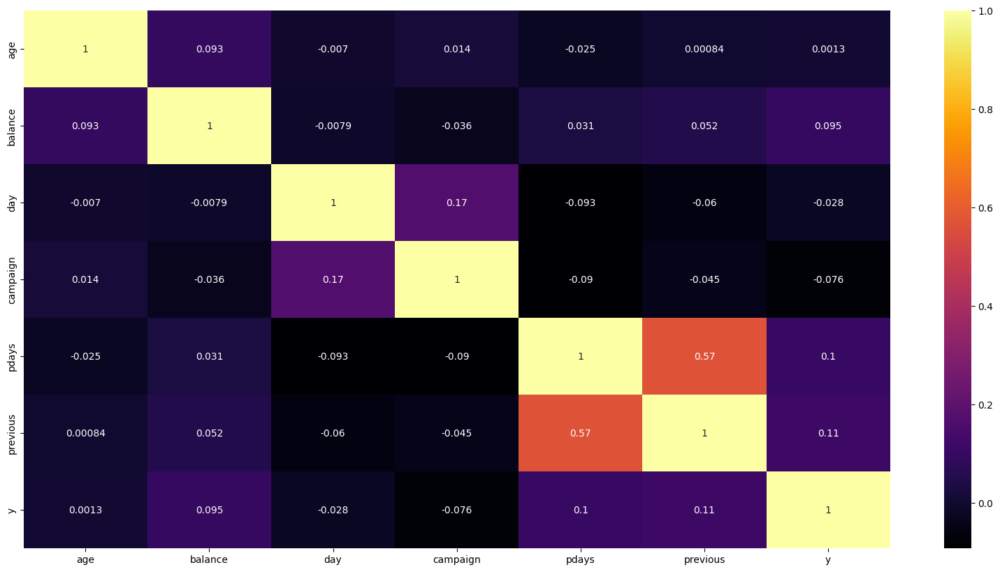

In [488]:
checkCorrFF(dfKmeans)

In [489]:
selector = SelectKBest(f_classif, k=4)
X = dfKmeans.drop(['y'], axis=1)
y = dfKmeans['y']
dfKmeans = selector.fit(X, y)
col = selector.get_support(indices=True)
dfKmeans = X.iloc[:,col]
dfKmeans = pd.concat([dfKmeans, y], axis=1)
dfKmeans.head()

,balance,campaign,pdays,previous,y
0,0.589847,0.0,0.0,0.0,0
1,0.413829,0.0,0.0,0.0,0
2,0.381344,0.0,0.0,0.0,0
3,0.564212,0.0,0.0,0.0,0
4,0.376685,0.0,0.0,0.0,0


##### **PCA**

<hr>

In [490]:
def plot3Dscatter(components, target, pathToImg = None, title = None):
    ax = [components.columns[0], components.columns[1], components.columns[2]]
    components = components.to_numpy()
    fig = px.scatter_3d(
        components, x=0, y=1, z=2, color=target,
        labels = {
        str(i): f"{var}"
        for i, var in enumerate(ax)
        },
        title = title,
        width=800, height=800
    )
    if pathToImg != None:
        fig.write_image(pathToImg) 
    fig.show()

In [491]:
dfKmeans.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
balance,45135.0,0.492185,0.117464,0.0,0.433328,0.495910,0.560461,1.0
campaign,45135.0,0.046004,0.078667,0.0,0.000000,0.026316,0.052632,1.0
pdays,45135.0,0.047148,0.114638,0.0,0.000000,0.000000,0.000000,1.0
previous,45135.0,0.019272,0.060389,0.0,0.000000,0.000000,0.000000,1.0
y,45135.0,0.116717,0.321086,0.0,0.000000,0.000000,0.000000,1.0


[0.40544439 0.3683288  0.16579882 0.06042798]


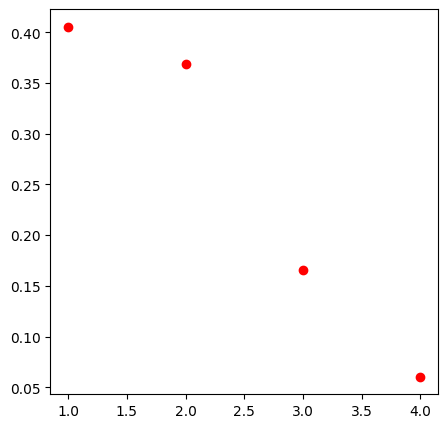

In [492]:
pca = PCA(n_components = len(dfKmeans.drop('y',axis = 1).columns))           
pca_data = pca.fit_transform(dfKmeans.drop('y',axis = 1))          

print(pca.explained_variance_ratio_)

plt.figure(figsize=(5,5))
for i in range(0, len(pca.explained_variance_ratio_)):
    plt.plot(i+1, pca.explained_variance_ratio_[i], 'ro')
plt.show()

['PC1', 'PC2', 'PC3', 'PC4']


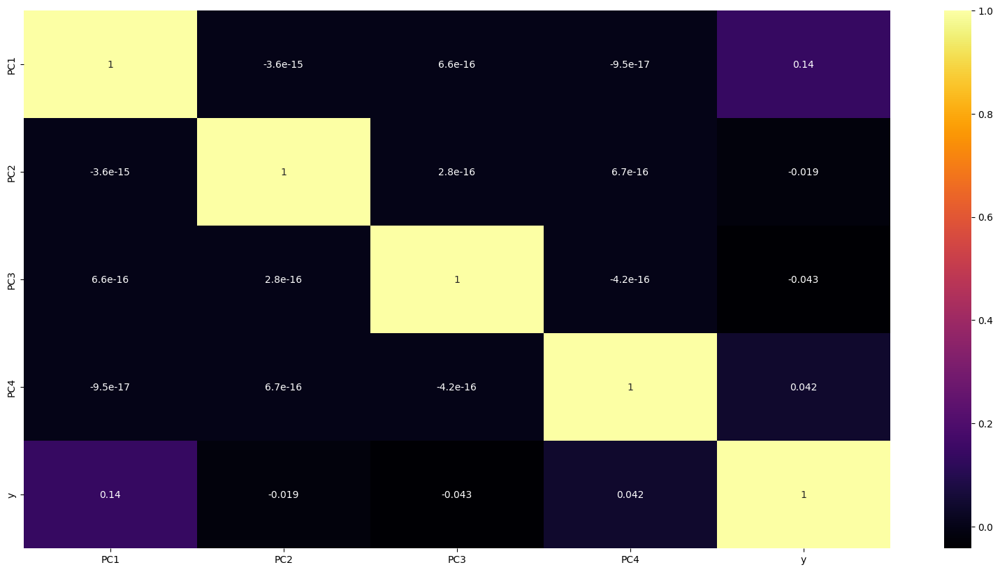

In [493]:
col = [
    str(f'PC{i+1}') for i in range(0, len(pca.explained_variance_ratio_))
    ]

print(col)
X = pd.DataFrame(pca_data, columns = col)
checkCorrFF(pd.concat([X, dfKmeans['y']], axis = 1))

In [505]:
pca = PCA(n_components = 3) # 86% of Data represent
x_pca = pca.fit_transform(dfKmeans.drop('y',axis = 1))
y_pca = dfKmeans['y']
y_pca.reset_index(drop=True, inplace=True)
col = [
    str(f'PC{i+1}') for i in range(0, len(pca.explained_variance_ratio_))
    ]

dfPCA = pd.DataFrame(x_pca, columns = col)
dfPCA = pd.concat([dfPCA, y_pca], axis = 1)
dfPCA.describe()

,PC1,PC2,PC3,y
count,4.513500e+04,4.513500e+04,4.513500e+04,45135.000000
mean,1.259409e-17,-2.802185e-17,7.556453e-18,0.116717
std,1.221076e-01,1.163844e-01,7.808504e-02,0.321086
min,-2.632219e-01,-4.853559e-01,-6.763024e-02,0.000000
25%,-6.649868e-02,-7.066726e-02,-4.711844e-02,0.000000
50%,-3.404958e-02,-1.045102e-02,-2.313938e-02,0.000000
75%,1.930539e-02,7.091923e-02,1.004587e-02,0.000000
max,8.449281e-01,5.139605e-01,9.400562e-01,1.000000


In [506]:
dfPCA

,PC1,PC2,PC3,y
0,0.002409,-0.109574,-0.047199,0
1,-0.075253,0.048227,-0.053492,0
2,-0.089586,0.077350,-0.054654,0
3,-0.008902,-0.086592,-0.048115,0
4,-0.091642,0.081526,-0.054820,0
...,...,...,...,...
45130,-0.030759,-0.053651,0.002892,1
45131,-0.007322,-0.095537,-0.021598,1
45132,0.240461,-0.087316,0.083784,1
45133,-0.038489,-0.043681,0.028654,0


test

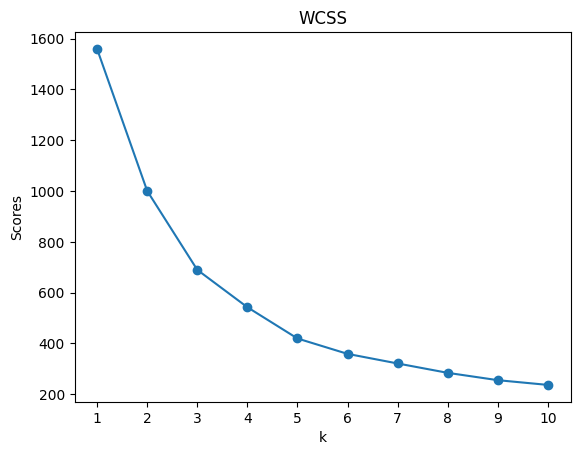

In [507]:
Num_K = [i+1 for i in range(10)]
WCSS = []

for k in Num_K:
  kmeans_clf_Ex1 = KMeans(n_clusters=k,
                          random_state=1,
                          )
  model = kmeans_clf_Ex1.fit(dfPCA.drop('y', axis=1))
  WCSS.append(model.inertia_)
  
plt.scatter(Num_K,WCSS )
plt.plot(Num_K,WCSS )
plt.title('WCSS')
plt.xticks(Num_K)
plt.ylabel('Scores'),plt.xlabel('k')
plt.show()

In [524]:
n_cluster = 5
kmeans_clf_PCA = KMeans(n_clusters= n_cluster, random_state=1)
kmeans_clf_PCA = kmeans_clf_PCA.fit(dfPCA.drop(['y'], axis=1))

Pridict = kmeans_clf_PCA.predict(dfPCA.drop(['y'], axis=1))
score = rand_score(dfPCA['y'], Pridict)
# rc = silhouette_score(dfPCA.drop(['y'], axis=1), Pridict, metric='euclidean', random_state=1)
# print('Silhouette score: ', rc)
print('Rand score: ', score)
print('Model Centroids: \n', kmeans_clf_PCA.cluster_centers_)

dfPred = pd.DataFrame(Pridict, columns = ['y'])
X = dfPCA.drop(['y'], axis=1)
y = dfPred['y']
plot3Dscatter(X, y, title = f'Kmeans Clustering n_clusters = {n_cluster}')

Rand score:  0.39159496739099847
Model Centroids: 
 [[ 0.25383814  0.1184135   0.01078184]
 [-0.04064471 -0.01810591 -0.01542282]
 [ 0.0365796  -0.14927475 -0.00881032]
 [-0.11777585  0.13867274 -0.01809161]
 [-0.08386087 -0.01138673  0.3093507 ]]


In [509]:
X = dfPCA.drop(['y'], axis=1)
y = dfPCA['y']
plot3Dscatter(X, y)

In [510]:
n_component= len(dfKmeans.drop('y',axis = 1).columns)
# n_component = 3
pca = PCA(n_components = n_component)
components = pca.fit_transform(dfKmeans.drop('y',axis = 1))
labels = {
    str(i): f"PC {i+1} ({var:.1f}%)"
    for i, var in enumerate(pca.explained_variance_ratio_ * 100)
}

fig = px.scatter_matrix(
    components,
    labels=labels,
    dimensions=range(n_component),
    color=dfKmeans["y"],
    width=1500,
    height=1500,
)
fig.update_traces(diagonal_visible=False)
fig.show()

In [511]:
import plotly.express as px
from sklearn.decomposition import PCA

df = dfKmeans
X = dfKmeans.drop('y',axis = 1)
y = dfKmeans['y']
# n_components = len(dfKmeans.drop('y',axis = 1).columns)
n_component = 3

pca = PCA(n_components=n_component)
components = pca.fit_transform(X)

total_var = pca.explained_variance_ratio_.sum() * 100

fig = px.scatter_3d(
    components, x=0, y=1, z=2, color=df['y'],
    title=f'Total Explained Variance: {total_var:.2f}%',
    labels={'0': 'PC 1', '1': 'PC 2', '2': 'PC 3'},
    width=800, height=800
)
fig.show()

In [512]:
components

array([[ 0.00240863, -0.10957418, -0.04719863],
       [-0.07525337,  0.04822652, -0.05349206],
       [-0.08958638,  0.07734962, -0.05465356],
       ...,
       [ 0.2404614 , -0.08731621,  0.08378364],
       [-0.03848884, -0.04368053,  0.02865432],
       [ 0.30978585,  0.00892324,  0.01785783]])

<hr>

In [513]:
# df = pd.read_csv('../HWdata/credit_card_churn.csv')
# df.tail()

In [514]:
# df['Attrition_Flag'] = df['Attrition_Flag'].apply(lambda x: 1 if x == 'Existing Customer' else 0)

# cat_cols = df.select_dtypes(include=['object']).columns
# df = df.drop(cat_cols, axis=1)
# df = df.drop(['CLIENTNUM','Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_1','Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_2'], axis=1)
# X = df.drop('Attrition_Flag', axis=1)
# y = df['Attrition_Flag']
# df = pd.concat([X, y], axis=1)
# df.head()

In [515]:
# MinMaxScale = Pipeline(steps=[
#     ('scaler', MinMaxScaler())
# ])

# for idx in df.columns:
#     if idx not in ['Attrition_Flag']:
#         df[idx] = MinMaxScale.fit_transform(df.drop(['Attrition_Flag'], axis = 1)[idx].values.reshape(-1,1))
        
# df.describe()

In [516]:
# import plotly.express as px
# from sklearn.decomposition import PCA

# features = df.columns

# pca = PCA(n_components = len(df.drop('Attrition_Flag',axis = 1).columns))
# components = pca.fit_transform(df.drop('Attrition_Flag',axis = 1))
# labels = {
#     str(i): f"PC {i+1} ({var:.1f}%)"
#     for i, var in enumerate(pca.explained_variance_ratio_ * 100)
# }

# fig = px.scatter_matrix(
#     components,
#     labels=labels,
#     dimensions=range(len(df.drop('Attrition_Flag',axis = 1).columns)),
#     color=df["Attrition_Flag"],
#     width=3000,
#     height=3000
# )
# fig.update_traces(diagonal_visible=False)
# fig.show()

In [517]:
# import plotly.express as px
# from sklearn.decomposition import PCA

# X = df.drop('Attrition_Flag',axis = 1)
# y = df['Attrition_Flag']
# # n_components = len(dfKmeans.drop('y',axis = 1).columns)
# n_component = 3

# pca = PCA(n_components=n_component)
# components = pca.fit_transform(X)

# total_var = pca.explained_variance_ratio_.sum() * 100

# fig = px.scatter_3d(
#     components, x=0, y=1, z=2, color=df['Attrition_Flag'],
#     title=f'Total Explained Variance: {total_var:.2f}%',
#     labels={'0': 'PC 1', '1': 'PC 2', '2': 'PC 3'},
#     width=800, height=800
# )
# fig.show()